### Import Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter
from matplotlib.ticker import FuncFormatter
from matplotlib.tri import Triangulation, LinearTriInterpolator
import ipywidgets as widgets
from ipywidgets import interactive, FloatSlider
from IPython.display import display

from sklearn.metrics import explained_variance_score, max_error, mean_absolute_error
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from DNN import Regressor

import os
import re
import time
from zipfile import ZipFile

# Orthogonal Legendre and Hermite polynomials
from numpy import polynomial as P
from scipy import special
from scipy.special import legendre, hermite
from scipy.special import eval_legendre
from scipy.interpolate import griddata

from matplotlib import rc
rc('mathtext', fontset='cm')

### Global variables

In [2]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

if torch.cuda.is_available():
    torch.cuda.set_device(device)


selected_columns = ['cos(theta)', 'R_surf', 'dR_dtheta', 'g_surf', 'Rpole_num', 'Req_num', 
                    'Rpol/Req', 'ellipticity', 'eccentricity', 'rho_c', 'r_ratio', 'M', 'M(km)',
                    'Req', 'C', 'K', 'g_0(km^(-1))', 'Ibar', 'f(Hz)', 'f_tilde', 'Jgeom(km^2)',
                    'x', 'sigma', 'T/W', 'Mxf_tilde', 'Rxf_tilde', 'Qbar', 'S3bar', 'EoS']

selected_features = ['|cos(theta)|', 'C', 'sigma', 'eccentricity']

abs_mu_min, abs_mu_max = 0., 1. 
C_min, C_max = 0.0876346858172578, 0.3094541325480277
sigma_min, sigma_max = 0., 0.9612274013913829
eccentricity_min, eccentricity_max = 0., 0.7797886226038347

min_values = np.array([abs_mu_min, C_min, sigma_min, eccentricity_min])
max_values = np.array([abs_mu_max, C_max, sigma_max, eccentricity_max])

feature_scaler = lambda data: (data - min_values) / (max_values - min_values)

N_MU = 521

#### Read Star Data

In [3]:
def read_zip(file_name, spin, test_percentage=0.2):
    # random seed for 'freezing' randomness
    SEED = 42
    rng = np.random.default_rng(SEED)
    
    # specifying the zip file name
    columns_names = ['cos(theta)', 'R_surf', 'dR_dtheta', 'g_surf', 'Rpole_num', 'Req_num', 'Rpol/Req',
                    'ellipticity', 'eccentricity', 'P_c', 'rho_c', 'r_ratio', 'r_e', 'M', 'M(km)',
                    'Req', 'C', 'K', 'g_0(km^(-1))', 'I(kgkm^2)', 'I(km^3)', 'Ibar', 'Z_p', 'Z_b',
                    'Z_f', 'Ω(Hz)', 'f(Hz)', 'f_tilde', 'Jgeom(km^2)', 'x', 'sigma', 'T/W',
                    'Mxf_tilde', 'Rxf_tilde', 'conv_rad', 'conv_plus', 'conv_minus', 'h_plus',
                    'h_minus', 'r_plus', 'r_minus', 'Q(km^3)', 'Qbar', 'S3(km^4)', 'S3bar', 'M4_geom',
                    'M4_asy^GH_geom', 'M4_asy_geom', 'M4_geom_2points', 'M4_geom_3points',
                    'M4_geom_4points', 'S5_geom', 'S5_asy_geom', 'EoS']
    
    g_scaling = lambda g_mu, g_pole, g_eq: (g_mu - g_pole) / (g_eq - g_pole)
    
    df_train, df_test = pd.DataFrame(), pd.DataFrame()
    # opening the zip file in READ mode
    with ZipFile(file_name, 'r') as zip:
        # Pop the folder from the list of stars
        zip.infolist().pop(0)
        
        star_train, star_test = list(), list()
        n_stars = len(zip.infolist())
        n_test_stars = int(n_stars * test_percentage)
        test_indexes = rng.choice(n_stars, n_test_stars, replace=False)
        
        for index, star in enumerate(zip.infolist()):
            star = zip.extract(star)
            df_star = pd.read_csv(star, sep=' ', names=columns_names, skiprows=1)
            
            # Keep stars that only with r_ration >= 0.6
            if df_star['r_ratio'].iloc[0] < 0.6: continue
            repeat_values = df_star.iloc[0].values
            df_star.iloc[1:, 4:] = repeat_values[4:]
            
            # Select only this columns to save memory
            df_star = df_star[selected_columns]
              
            # Output normalization
            if np.all(df_star[spin] == 0.0):
                # Avoid zero division to static case
                df_star['g_scaled'] = df_star['g_surf']
            else:
                # Min max scaling at star level
                df_star['g_scaled'] = g_scaling(df_star['g_surf'], df_star['g_surf'].iloc[-1], df_star['g_surf'].iloc[0])

            if index in test_indexes:
                star_test.append(df_star)
            else:
                star_train.append(df_star)
                
        # Concat the dataframes to train and test
        if star_train: df_train = pd.concat(star_train, ignore_index=True)
        if star_test: df_test = pd.concat(star_test, ignore_index=True)
        
    return df_train, df_test

In [4]:
def load_stars(df, batch_size=4096, shuffle=True):
    df_target = df['g_scaled']
    
    # Z_2 Symmetry constrain
    df['|cos(theta)|'] = np.abs(df['cos(theta)'])

    np_features = df[selected_features].to_numpy()    
    np_targets = df_target.to_numpy()
    np_targets = np.reshape(np_targets, (np_targets.shape[0], 1))
    
    tr_features = torch.Tensor(feature_scaler(np_features))
    input_dimension = tr_features.shape[1]
    
    tr_targets = torch.Tensor(np_targets)
    final_dataset = TensorDataset(tr_features, tr_targets)

    # pin_memory=True, num_workers >= 1 if data is not already on device and model is training
    dataloader = DataLoader(final_dataset, batch_size=batch_size, shuffle=shuffle, num_workers=1, pin_memory=True)

    return dataloader, input_dimension, np_features, np_targets

In [5]:
def Surface_plot(df, x,y,w, z, xlabel,ylabel,wlabel,zlabel, view2, n_col,
                         border_axes, X,Y,W, Z, l_w):
    
    fig = plt.figure(figsize=(20 ,16)) 
    labels_text_size = 40
    ax = fig.add_subplot(111, projection='3d')

    dot_size = 40
    font_size = 40
    label_pad = 40
    label_size = 30
    
    #######################################################################################################
    mu_values = [0.000,0.45769231,0.78461538,1.000]
    colors = ['green', 'pink', 'cyan', 'purple']
    
    for i in range(0,len(mu_values)):
        scatter = ax.scatter(df[df['mu']==mu_values[i]][x].to_numpy(), df[df['mu']==mu_values[i]][y].to_numpy(),df[df['mu']==mu_values[i]][z].to_numpy(),
                   c = df[df['mu']==mu_values[i]][w].to_numpy(), s = dot_size, cmap='coolwarm', marker='o', alpha = 0.8)    


        triang = Triangulation(df[df['mu']==mu_values[i]][x].to_numpy(), df[df['mu']==mu_values[i]][y].to_numpy())
        interpolator = LinearTriInterpolator(triang, df[df['mu']==mu_values[i]][z].to_numpy())
        grid_x, grid_y = np.mgrid[0.0901155694351282:0.3062042574717896:500j, 0.0329041860812303:0.9416722276120412:500j]
        grid_z = interpolator(grid_x, grid_y)
        ax.plot_surface(grid_x, grid_y, grid_z, color = colors[i], alpha = 0.8, label = f'Interpolated surface with $\mu_\star$ = {np.round(mu_values[i],3)}', zorder = 5)

    # Add colorbar
    cbar = plt.colorbar(scatter,  shrink=0.5)
    cbar.set_label(wlabel, fontsize=font_size, rotation = 0)
    cbar.ax.tick_params(labelsize=23)

    ax.view_init(30, view2)   
    ax.set_xlabel(xlabel, fontsize=font_size,labelpad=label_pad) 
    ax.set_ylabel(ylabel, fontsize=font_size,labelpad=label_pad) 
    
    ax.zaxis.set_rotate_label(False)
    ax.set_zlabel(zlabel, fontsize=font_size,labelpad=label_pad,rotation = 90) 
    #ax.yaxis._axinfo['label']['space_factor'] = 3.0   

    ax.yaxis.labelpad = 30
    ax.zaxis.labelpad = 20
    
    ax.xaxis.set_tick_params(labelsize=label_size)
    ax.yaxis.set_tick_params(labelsize=label_size)
    ax.zaxis.set_tick_params(labelsize=label_size)
    
    for axis in [ax.xaxis, ax.yaxis, ax.zaxis]:
        axis.line.set_linewidth(3)
    
    ax.grid(False)


    leg = plt.legend(loc="best",ncol=n_col, borderaxespad=border_axes, prop={'size': 20}, shadow=True, fontsize="large")    #,bbox_to_anchor=(1,1)
    leg.get_frame().set_linewidth(3.0)
    leg.get_frame().set_edgecolor('black')
    
    plt.tight_layout()
    
    plt.show()

### Evaluation: statistical evaluation measures

### Evaluation of the total Regression ANN model performance to the whole NSs Dataset test set

In [6]:
df_eval_dataset = pd.read_csv('./Experimental Results/Effective-Gravity/dataset_measures.csv')
df_eval_dataset

,explained_variance,max_error,mean_absolute_error,mean_squared_error,r2_score,mean_absolute_percentage_error,eval_eos_type,eval_eos_name
0,0.999992,0.00773,0.000338,4.512352e-07,0.999992,0.000344,NaN,NaN


In [49]:
df_eval_dataset = pd.read_csv('./Experimental Results/Effective-Gravity/dataset_measures.csv')
df_eval_dataset

,explained_variance,max_error,mean_absolute_error,mean_squared_error,r2_score,mean_absolute_percentage_error,eval_eos_type,eval_eos_name
0,0.999992,0.00773,0.000338,4.512352e-07,0.999992,0.000344,NaN,NaN


### Evaluation of the trained ANN model to the whole NS's data (per EOS level) [test dataset]

In [8]:
df_eval_eos = pd.read_csv('./Experimental Results/Effective-Gravity/EOS_measures.csv')
df_eval_eos = df_eval_eos.sort_values(by = ['eval_eos_type', 'eval_eos_name'])
df_eval_eos.reset_index(drop = True, inplace = True)
df_eval_eos

,explained_variance,max_error,mean_absolute_error,mean_squared_error,r2_score,mean_absolute_percentage_error,eval_eos_type,eval_eos_name
0,0.999997,0.003323,0.000239,1.905879e-07,0.999997,0.000244,Hadronic,BL_2018
1,0.999995,0.003844,0.000303,3.420295e-07,0.999995,0.000305,Hadronic,BSK22
2,0.999993,0.005413,0.000318,4.496382e-07,0.999993,0.000322,Hadronic,BSK24
3,0.999990,0.006004,0.000446,7.214546e-07,0.999988,0.000444,Hadronic,BSK25
4,0.999995,0.005449,0.000316,3.506700e-07,0.999993,0.000326,Hadronic,BSK26
...,...,...,...,...,...,...,...,...
65,0.999993,0.004464,0.000407,4.830259e-07,0.999992,0.000402,Hyperonic,DS(CMF)-3
66,0.999998,0.002719,0.000195,1.279006e-07,0.999998,0.000196,Hyperonic,DS(CMF)-5
67,0.999998,0.002712,0.000191,1.061575e-07,0.999998,0.000193,Hyperonic,DS(CMF)-7
68,0.999997,0.003194,0.000238,1.983635e-07,0.999997,0.000240,Hyperonic,GM1 Y5


### Evaluation measures for the trained ANN model to the star level [NSs at test dataset]

In [9]:
#note: follow the ./Experimental Results/Effective-Gravity/ path and unzip the perc_error_star_level.zip file
df = pd.read_csv('./Experimental Results/Effective-Gravity/perc_error_star_level.csv')

In [10]:
#df['g_scaled'] = df['g_surf']/df['g_0']

In [11]:
C_min = df[df['sigma'] != 0]['C'].min(); C_max = df[df['sigma'] != 0]['C'].max();
sigma_min = df[df['sigma'] != 0]['sigma'].min(); sigma_max = df[df['sigma'] != 0]['sigma'].max()

In [12]:
df_new = df[df['sigma'] !=0].copy()

In [13]:
g_min_max = df_new['g_scaled']

mu_var = df_new['mu']
e_var = df_new['eccentricity']
z_1 = df_new['percentange_error']
C_var = df_new['C']
sigma_var = df_new['sigma']

In [14]:
df_new

,percentange_error,residual,star_id,mu,g_surf,g_0,g_scaled,C,sigma,eccentricity,eval_eos_type,eval_eos_name
0,0.041721,0.000149,0,0.000000,0.005974,0.016730,1.000000,0.207095,0.735137,0.730157,Hyperonic,DS(CMF)-5
1,0.046917,0.000168,0,0.001923,0.005975,0.016730,0.999981,0.207095,0.735137,0.730157,Hyperonic,DS(CMF)-5
2,0.047352,0.000169,0,0.003846,0.005975,0.016730,0.999941,0.207095,0.735137,0.730157,Hyperonic,DS(CMF)-5
3,0.041759,0.000149,0,0.005769,0.005977,0.016730,0.999872,0.207095,0.735137,0.730157,Hyperonic,DS(CMF)-5
4,0.029527,0.000106,0,0.007692,0.005979,0.016730,0.999770,0.207095,0.735137,0.730157,Hyperonic,DS(CMF)-5
...,...,...,...,...,...,...,...,...,...,...,...,...
4447251,0.002284,0.000029,121,0.992308,0.026326,0.020671,0.010611,0.223218,0.329564,0.555045,Hybrid,OOS(DD2-FRG)-2 flavors
4447252,-0.006433,-0.000082,121,0.994231,0.026354,0.020671,0.007906,0.223218,0.329564,0.555045,Hybrid,OOS(DD2-FRG)-2 flavors
4447253,-0.003755,-0.000048,121,0.996154,0.026383,0.020671,0.005195,0.223218,0.329564,0.555045,Hybrid,OOS(DD2-FRG)-2 flavors
4447254,-0.001670,-0.000021,121,0.998077,0.026410,0.020671,0.002549,0.223218,0.329564,0.555045,Hybrid,OOS(DD2-FRG)-2 flavors


### Universal description for fixed $\mu$ values

In [15]:
x = 'C'; y = 'sigma'; w = 'eccentricity' ;z = 'g_scaled' ; z_model = '';

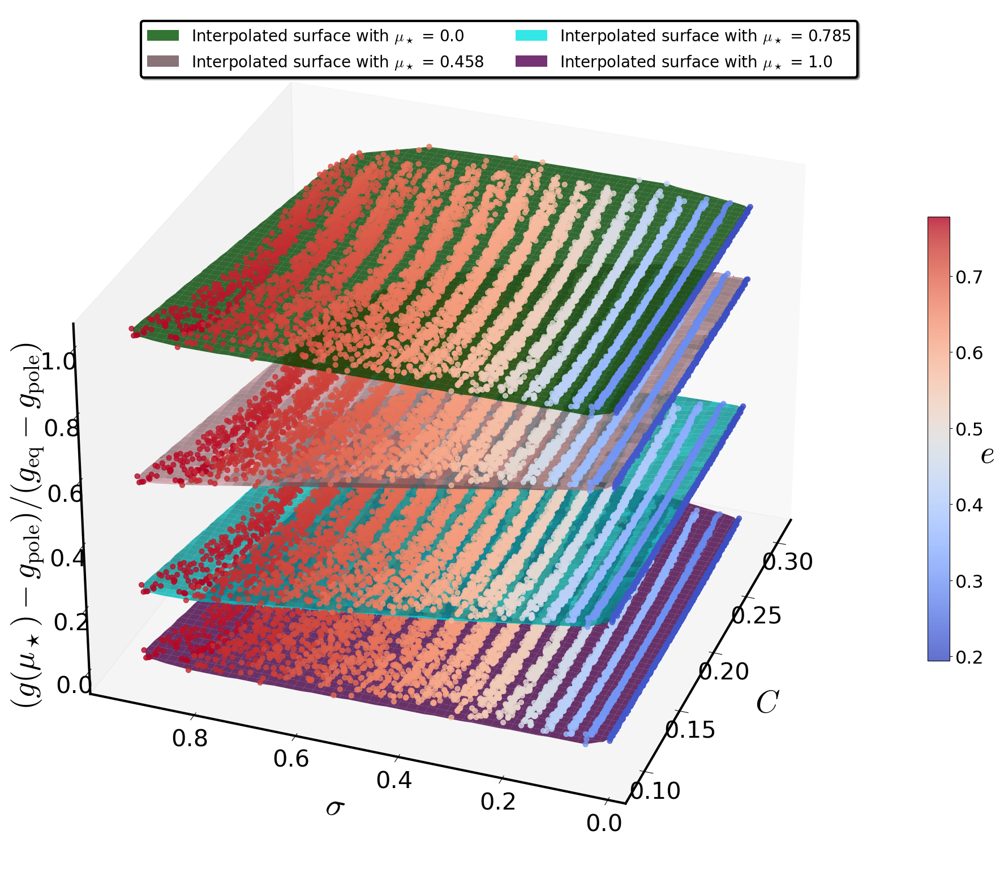

In [16]:
Surface_plot(df_new, x,y,w,z, xlabel=r'$C$',ylabel='$\sigma$',
                     wlabel = r'$e$',zlabel=r'$(g(\mu_\star) - g_{\mathrm{pole}})/(g_{\mathrm{eq}} - g_{\mathrm{pole}})$', 
                     view2=200, n_col=2, border_axes=1, X=None,Y=None,W = None,Z=None, l_w=1.5)

### Universal description for each $\mu$ value

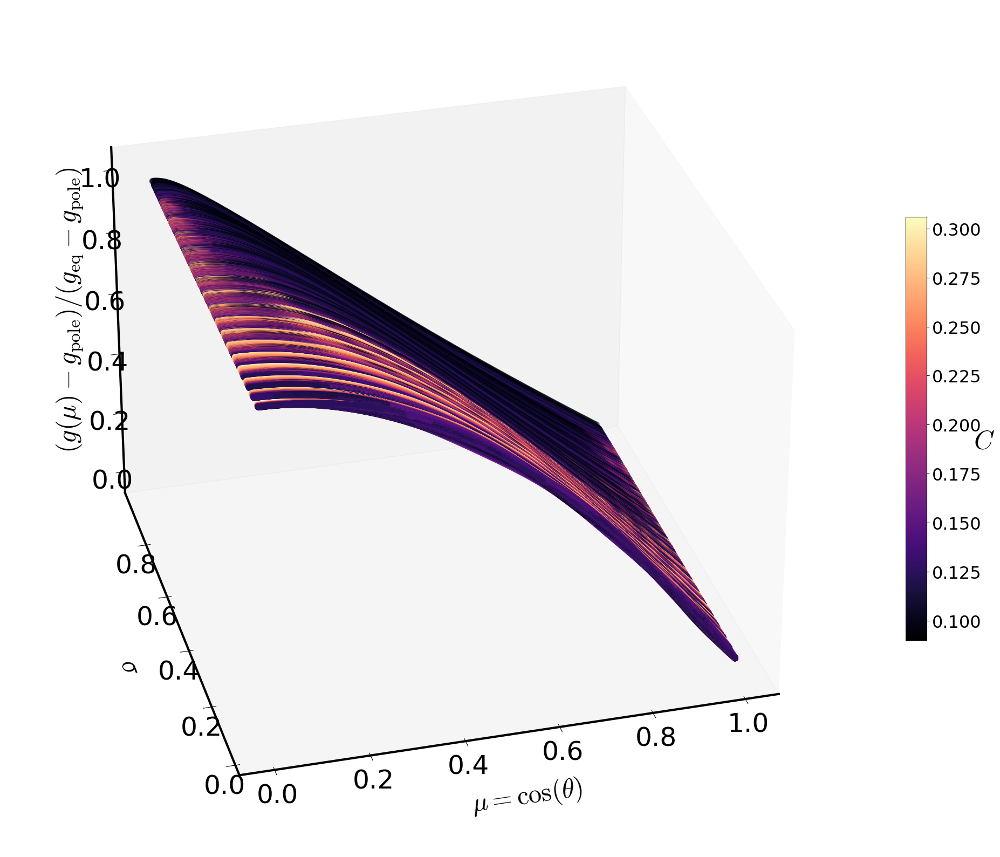

In [17]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np


fig = plt.figure(figsize=(20, 16))
labels_text_size = 40
ax = fig.add_subplot(111, projection='3d')
dot_size = 60
font_size = 35
label_pad = 35
label_size = 35



# 3D scatter plot with q encoded as color
scatter = ax.scatter(mu_var, sigma_var, g_min_max, c=C_var, cmap='magma', s=60)  # q affects color and size

cbar = plt.colorbar(scatter,  shrink=0.5, )
cbar.set_label(r'$C$', fontsize=font_size,rotation = 0)
cbar.ax.tick_params(labelsize=23)

ax.view_init(30, 255)   
    

ax.set_xlabel(r'$\mu = \cos(\theta)$', fontsize=font_size,labelpad=label_pad) 
ax.set_ylabel(r'$\sigma$', fontsize=font_size,labelpad=label_pad) 

ax.zaxis.set_rotate_label(False)
ax.set_zlabel(r'$(g(\mu) - g_{\mathrm{pole}})/(g_{\mathrm{eq}} - g_{\mathrm{pole}})$', fontsize=font_size,labelpad=label_pad,rotation = 90) 

ax.zaxis.labelpad = 25  
ax.xaxis.set_tick_params(labelsize=label_size)
ax.yaxis.set_tick_params(labelsize=label_size)
ax.zaxis.set_tick_params(labelsize=label_size)
    
for axis in [ax.xaxis, ax.yaxis, ax.zaxis]:
    axis.line.set_linewidth(3)
    
ax.grid(False)
plt.tight_layout()
plt.show()

### Percentage error histogram in the test set for the suggested ANN model's optimal weights

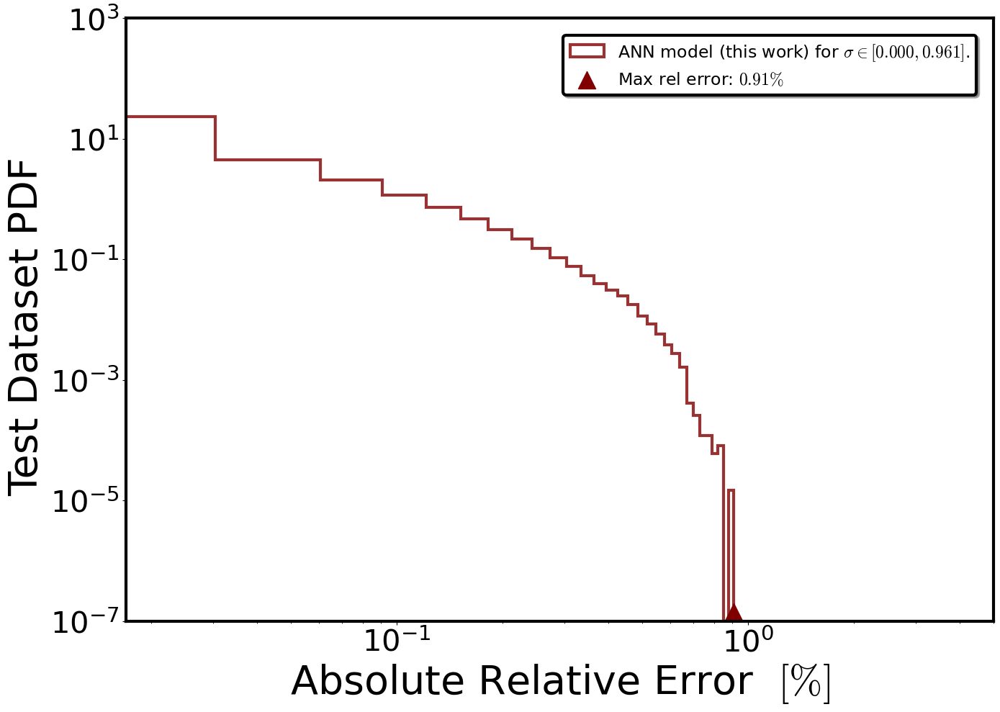

In [21]:
fig,ax = plt.subplots(figsize=(14, 10),)
labels_text_size = 40
plt.xticks(fontsize=30) #fontweight="bold"
plt.yticks(fontsize=30)

xlabel = r'Absolute Relative Error  $[\%]$'
ylabel = r'Test Dataset PDF '

plt.xlabel(xlabel,size=labels_text_size)
plt.ylabel(ylabel,size=labels_text_size)

bins = 50
alpha = 0.8


y_reg_model = abs(df['percentange_error']).hist(
                density = True,
                lw = 3,
                bins=bins-20,
                edgecolor ='maroon', 
                 histtype='step',
                zorder = 1,
                alpha = alpha, 
                label = 'ANN model (this work) for $\sigma \in [0.000,0.961]$.', color = 'maroon').autoscale(enable = True, axis = 'both', tight = True)

vertical_lines = [abs(df['percentange_error']).max(), None]  # Adjust these values based on your requirements
plt.scatter(vertical_lines[0], 1.4e-7, color='maroon', marker='^', s=300, zorder=2, label=r'Max rel error: $0.91\%$')  # Star marker


# Customize plot appearance
for axis in ['top', 'bottom', 'left', 'right']:
    ax.spines[axis].set_linewidth(3.0)

# Set logarithmic scale 
plt.xscale('log')
plt.yscale('log')

# Adjust x,y-axis limits (optional, based on log scale)
plt.xlim(1.7e-2,5)
plt.ylim(1.e-7,1000)


# Grid, legend, and layout
plt.grid(False)
leg = plt.legend(loc="upper right",ncol=1, borderaxespad=1, prop={'size': 17}, shadow=True, fontsize="large")    #,bbox_to_anchor=(1,1)
leg.get_frame().set_linewidth(3.0)
leg.get_frame().set_edgecolor('black')


plt.tight_layout()
plt.show()


### ANN Regression Model for star's effective gravity: Evaluation on singular EOS

In [23]:
# Choose the case/EoS of your preference
# In this demo we provide indicatively for demonstration 3 EoS: 1 per star's category investigated

# Hadronic case
#file_name = './Surface models for Hadronic EOS/SLY4/'

# Hyperonic case
#file_name = './Surface models for Hyperonic EOS/DNS/'

# Hybrid case
file_name = './Surface models for Hybrid EOS/KBH(QHC21_AT)/'


In [24]:
spin = 'sigma' 
test_percentage = 0.2

rotational_path = os.path.join(file_name, 'rotational_models.zip')
static_path = os.path.join(file_name, 'static_models.zip')

df_rot_train, df_rot_test = read_zip(rotational_path, spin=spin, test_percentage=test_percentage)
df_stat_train, df_stat_test = read_zip(static_path, spin=spin, test_percentage=test_percentage)

df_train = pd.concat([df_rot_train, df_stat_train], ignore_index=True)
df_test = pd.concat([df_rot_test, df_stat_test], ignore_index=True)

# Free the memory space
del df_rot_train, df_rot_test, df_stat_train, df_stat_test

### Load the Trained Regression Model optimal weights to estimate for star's effective gravity 

In [25]:
batch_size = 4096
model_path = './Model/Effective-Gravity/Effective-Gravity-model.pth'

dataloader_tr, input_dimension, np_features_tr, np_targets_tr = load_stars(df_train, batch_size=batch_size)
dataloader_ts, _, np_features_ts, np_targets_ts = load_stars(df_test, batch_size=batch_size)

regressor = Regressor(input_dimension=input_dimension, feature_scaler=feature_scaler).to(device)
regressor.set_device(device)
regressor.load_state_dict(torch.load(model_path, map_location=torch.device(device)))
regressor.eval()

Regressor(
  (MLP): Sequential(
    (0): Linear(in_features=4, out_features=200, bias=True)
    (1): LeakyReLU(negative_slope=0.1, inplace=True)
    (2): Linear(in_features=200, out_features=100, bias=True)
    (3): LeakyReLU(negative_slope=0.1, inplace=True)
    (4): Linear(in_features=100, out_features=50, bias=True)
    (5): LeakyReLU(negative_slope=0.1, inplace=True)
    (6): Linear(in_features=50, out_features=25, bias=True)
    (7): LeakyReLU(negative_slope=0.1, inplace=True)
    (8): Linear(in_features=25, out_features=10, bias=True)
    (9): LeakyReLU(negative_slope=0.1, inplace=True)
    (10): Linear(in_features=10, out_features=1, bias=True)
    (11): Sigmoid()
  )
)

### Plot functions associated with residual and percentage errors

In [28]:
def plot_residuals(residual_error, percentage_error):
    witdh, height = 16, 6
    fontsize = 20
    labelsize = 15
    lw = 5
    
    fig, ax = plt.subplots(1, 2, figsize=(witdh, height))
    # Residual error subplot 
    ax[0].plot(residual_error, lw=lw)
    ax[0].set_xlabel(r'Data', fontsize=fontsize)
    ax[0].set_ylabel(r'Residual', fontsize=fontsize)
    ax[0].tick_params(axis='both', which='both', labelsize=labelsize)

    # Percentage error subplot 
    ax[1].plot(percentage_error, lw=lw)
    ax[1].set_xlabel(r'Data', fontsize=fontsize)
    ax[1].set_ylabel(r'Percentage Error$\ [\%]$', fontsize=fontsize)
    ax[1].tick_params(axis='both', which='both', labelsize=labelsize)

    plt.tight_layout()
    plt.show()
    
    fig, ax = plt.subplots(1, 2, figsize=(16, 6))
    fontsize = 20
    labelsize = 15
    lw = 5

    # Residula error histogram
    ax[0].hist(residual_error, lw=lw)
    ax[0].set_ylabel(r'Data', fontsize=fontsize)
    ax[0].set_xlabel(r'Residual', fontsize=fontsize)
    ax[0].tick_params(axis='both', which='both', labelsize=labelsize)

    # Percentage error histogram
    ax[1].hist(percentage_error, lw=lw)
    ax[1].set_ylabel(r'Data', fontsize=fontsize)
    ax[1].set_xlabel(r'Percentage Error$\  [\%]$', fontsize=fontsize)
    ax[1].tick_params(axis='both', which='both', labelsize=labelsize)

    plt.tight_layout()
    plt.show()

In [35]:
def plot_surface_effective_gravity(mu, model_estimation, real_targets, C, sigma):
    witdh, height = 10, 6
    fontsize = 20
    labelsize = 20
    lw = 5

    fig, ax = plt.subplots(figsize=(witdh, height))
    ax.plot(mu, model_estimation, lw=lw, c='maroon', label='ANN model (this work)')
    ax.scatter(mu, real_targets, c='black', s=20, marker='o', label='Numerical Data')

    plt.xlim(0,1)
    plt.ylim(real_targets.min()-0.05, real_targets.max()+0.05)
    plt.xlabel(r'$\mu = \cos(\theta)$', fontsize=fontsize)
    plt.ylabel(r'$g(\mu)/g_0$', fontsize=fontsize)
    
    plt.title(f'NS model with C={round(C,3)}, $\sigma$ = {round(sigma,3)}')

    plt.legend(loc='best', prop={'size':fontsize}, shadow=True, fontsize='large')
    ax.tick_params(axis='both', which='both', labelsize=labelsize)
    leg = plt.legend(loc="upper right", ncol=2, borderaxespad=1, prop={'size': 15.},  shadow=True, fontsize="large")
    leg.get_frame().set_linewidth(3.0)
    leg.get_frame().set_edgecolor('black')
    plt.tight_layout()
    plt.show()

#### Universal relations suggested in this work for the parameters $e$, $g_p/g_0$ and $g_e/g_0$ 

In [36]:
#def eccentricity(C, sigma):
#    return (
#        -99.173162625833 * C**5 +68.055729822908 * C**4 * sigma + 137.191420602024 * C**4 +12.9349885313244 * C**3 * sigma**2 -
#        57.474308297241 * C**3 * sigma -67.7948794729071 * C**3 -9.03315944594535 * C**2 * sigma**3 + 8.08346062523145 * C**2 * sigma**2 +
#        9.19713339469957 * C**2 * sigma + 14.9006458417145 * C**2 + 4.84885244516378 * C * sigma**4 -
#        6.44626099699536 * C * sigma**3 +2.75499036217858 * C * sigma**2 -
#        1.3329369261108 * C * sigma - 1.52533604289959 * C + 4.71450473450295 * sigma**5 -
#        13.8547513636472 * sigma**4 + 15.4712200610891 * sigma**3 - 8.71280504897915 * sigma**2 +
#        3.0422989983075 * sigma + 0.182560763719325
#    )

#def g_pole(g_0, C, sigma):
#    return (
#        g_0*(-62.8045467352441 * C**4 -23.2577694998269 * C**3 * sigma +
#        52.068673220798 * C**3 + 1.1160287935608 * C**2 * sigma**2 +
#        11.9714816462282 * C**2 * sigma - 15.6899254468899 * C**2 +
#        1.46606081557891 * C * sigma**3 - 1.46935053803789 * C * sigma**2 -
#        2.79057152330358 * C * sigma + 2.0186963881549 * C +
#        0.488086658631048 * sigma**4 - 0.800025443187691 * sigma**3 +
#        0.553202313363468 * sigma**2 + 1.08421869564885 * sigma + 0.908110925704064)
#    )


#def g_eq(g_0, C, sigma, e):
#    return (
#        g_0*(0.338070419688185 * C**3 +1.20592155663027 * C**2 * sigma +
#        0.12888785718781 * C**2 * e - 0.28467956062336 * C**2 -
#        4.03577574275211 * C * sigma**2 + 2.63090429234693 * C * sigma * e +
#        2.33122575049246 * C * sigma - 2.03273805025503 * C * e**2 +
#        0.141317760072598 * C * e + 0.0686633222621117 * C -
#        0.221009453432669 * sigma**3 + 0.36927602815501 * sigma**2 * e +
#        0.532800911941034 * sigma**2 + 0.230730659632592 * sigma * e**2 -
#        0.758366940518704 * sigma * e - 1.6917578234362 * sigma +
#        0.289040948522073 * e**3 + 0.83218178966767 * e**2 -
#        0.0297671570402102 * e + 0.995124108230518)
#    )

### Select NS model for estimating the effective gravity at surface as well as the corresponding residual errors

In [37]:
# Select Set (Train/Test)
is_train = True # True or False

# Select your favorite Star
star_index = 0

# Do not change
low = star_index * N_MU
high = (star_index + 1) * N_MU

select_set = lambda is_train, df_train, df_test: df_train if is_train else df_test
select_features = lambda is_train, np_features_tr, np_features_ts: np_features_tr if is_train else np_features_ts
select_targets = lambda is_train, np_targets_tr, np_targets_ts: np_targets_tr if is_train else np_targets_ts
    
# Select Set (Train/Test)
df_set = select_set(is_train, df_train, df_test)
features = select_features(is_train, np_features_tr, np_features_ts)
targets = select_targets(is_train, np_targets_tr, np_targets_ts)

# Estimate the star's effective gravity at surface
estimation = regressor.predict(features[low:high])

g_0 = df_set['g_0(km^(-1))'].iloc[low]
max_ = df_set['g_surf'].iloc[high - 1]
min_ = df_set['g_surf'].iloc[low]
minmax_diff = min_ - max_

#using parameter results coming from the universal realtions proposed

#g_0 = df_set['g_0(km^(-1))'].iloc[low]
C = df_set['C'].iloc[low]
sigma = df_set['sigma'].iloc[low]
#e = eccentricity(C, sigma)
#max_ = g_pole(g_0, C, sigma)
#min_ = g_eq(g_0, C, sigma, e)
#minmax_diff = min_ - max_
#############################################################################

# Static case
if np.all(df_set['sigma'].iloc[low:high] == 0):
    model_estimation = (estimation * min_)  / g_0 
    real_targets = (targets[low:high] * min_) / g_0
# Rotational case
else:
    model_estimation = (estimation * (minmax_diff) + max_)  / g_0
    real_targets = (targets[low:high] * (minmax_diff) + max_)  / g_0

mu = df_set['cos(theta)'].iloc[low:high]

### Residual and Percentage error computations

In [38]:
residual_error = model_estimation - real_targets
percentage_error = (residual_error / real_targets) * 100

### Error distributions a singular NS configuration

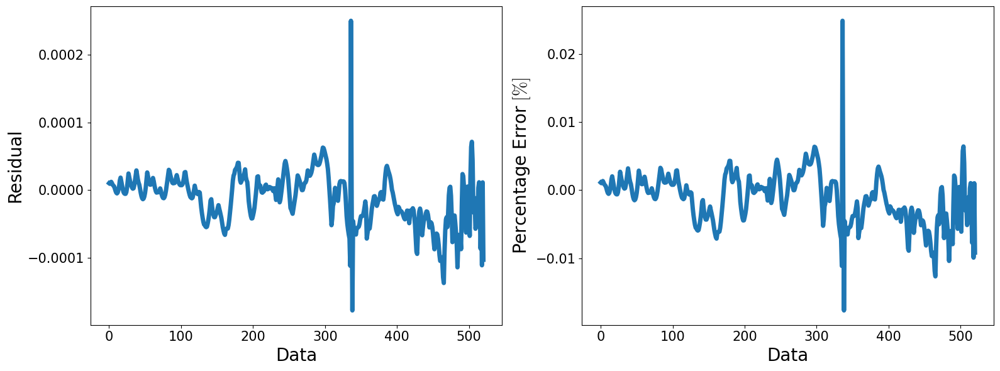

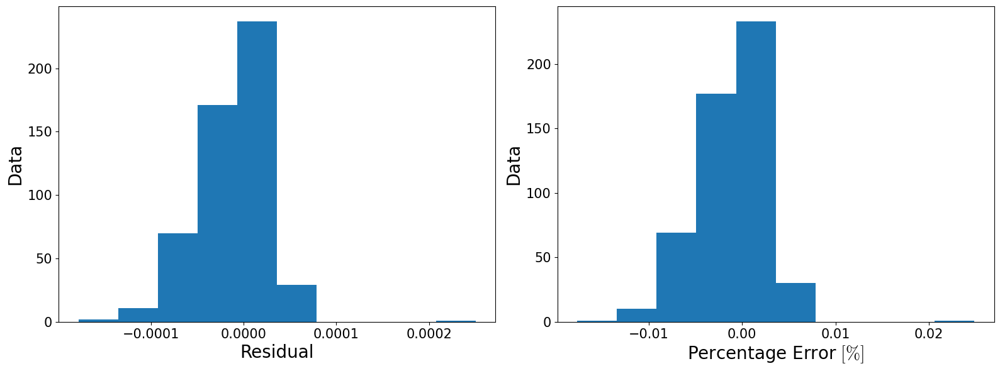

In [39]:
plot_residuals(residual_error, percentage_error)

### Effective gravity at surface for an indicative NS configuration

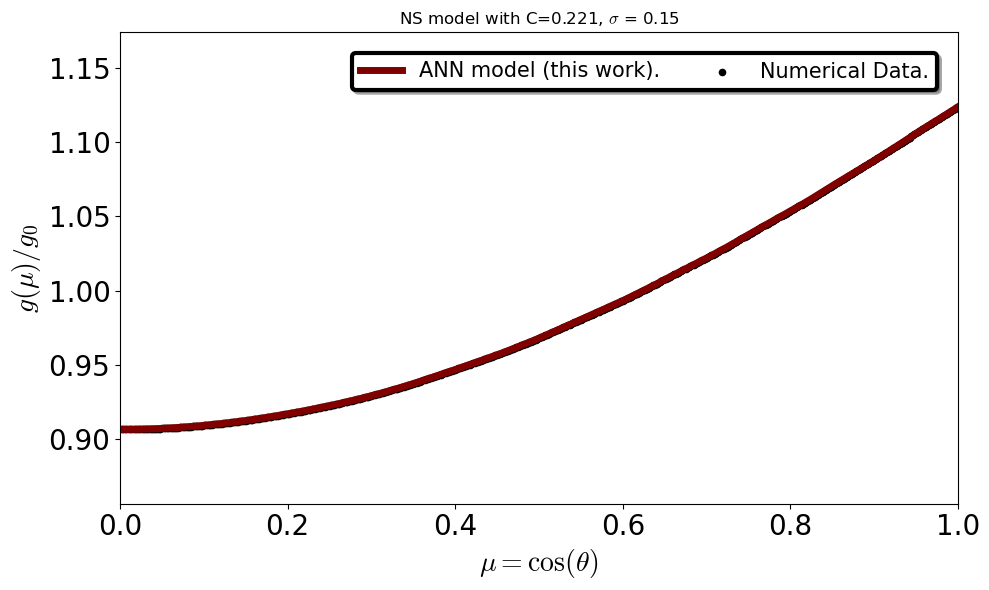

In [40]:
plot_surface_effective_gravity(mu, model_estimation, real_targets, df_set['C'].iloc[star_index * N_MU], df_set['sigma'].iloc[star_index * N_MU])

### Visualization of the all the effective gravity curves in the selected set (Train/Test) dataset for the specific EOS loaded

In [43]:
def calculate_model_estimation(C, sigma, R_pole, R_eq, g_pole_scaled, g_eq_scaled, g_0):
    num = 50
    mu = np.linspace(0, 1, num=num, dtype=np.float32)
    C_np = np.array([C for _ in range(0, num)], dtype=np.float32)
    sigma_np = np.array([sigma for _ in range(0, num)], dtype=np.float32)
    e_np = np.array([np.sqrt(1 - np.square(R_pole / R_eq)) for _ in range(0, num)], dtype=np.float32)
    x = torch.tensor(np.array([mu, C_np, sigma_np, e_np])).T.to(device) # Convert the argument list to array for optimization 

    #############################################################################################
    #Convert the estimation list to 1-d array with dtype float 32 in order 
    #to have the same dimenensions and dtype with mu = cos(theta)
    model_estimation = regressor(x).cpu().detach().numpy().ravel().astype(np.float32)
    model_estimation = (model_estimation * (g_eq_scaled - g_pole_scaled) + g_pole_scaled) / g_0
    #############################################################################################
    return mu, model_estimation

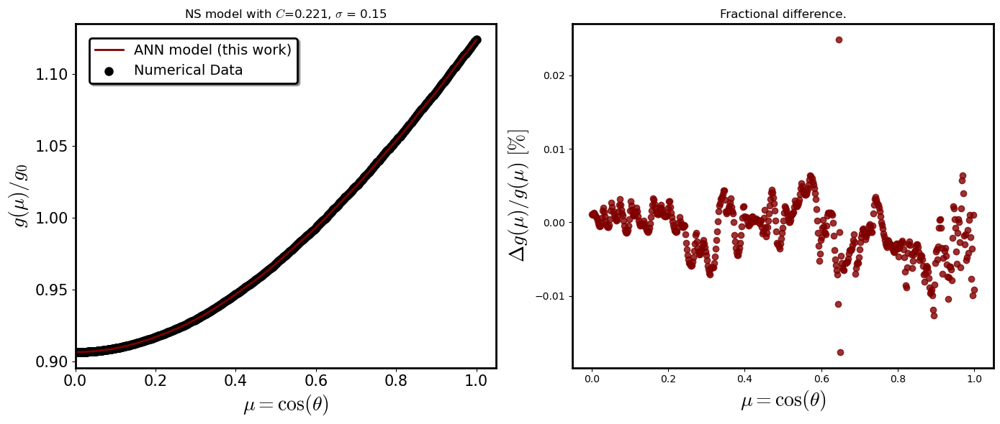

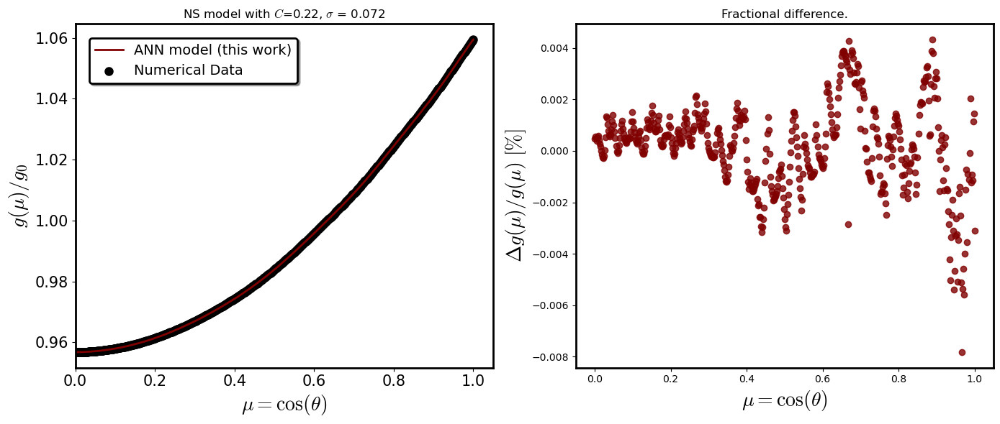

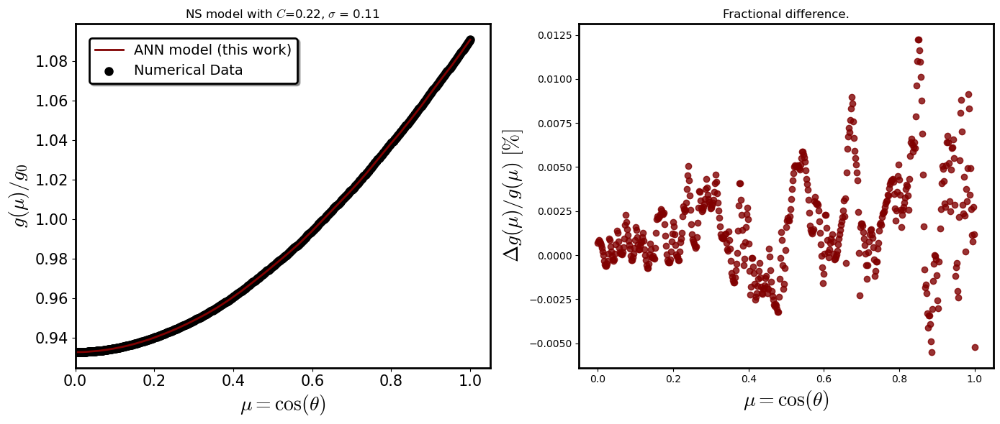

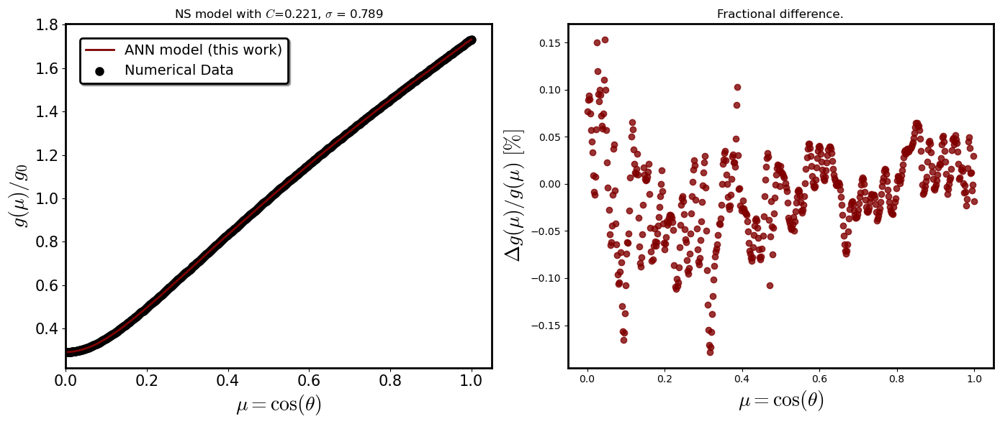

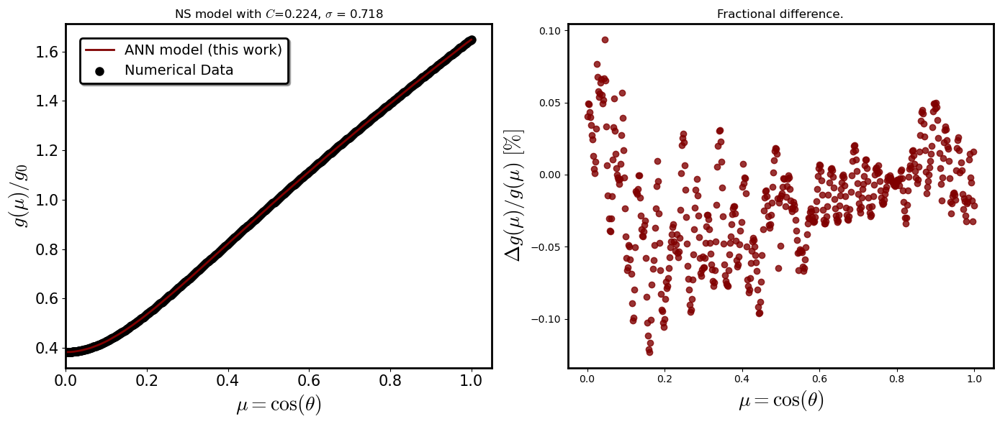

...

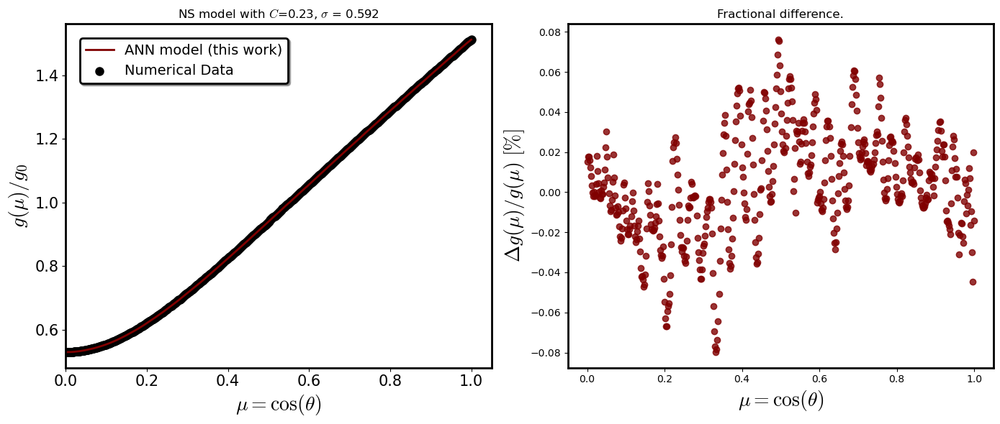

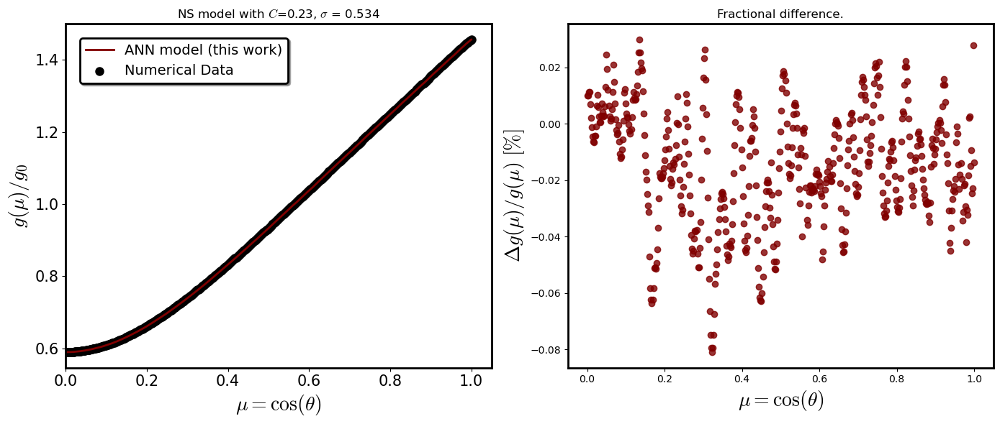

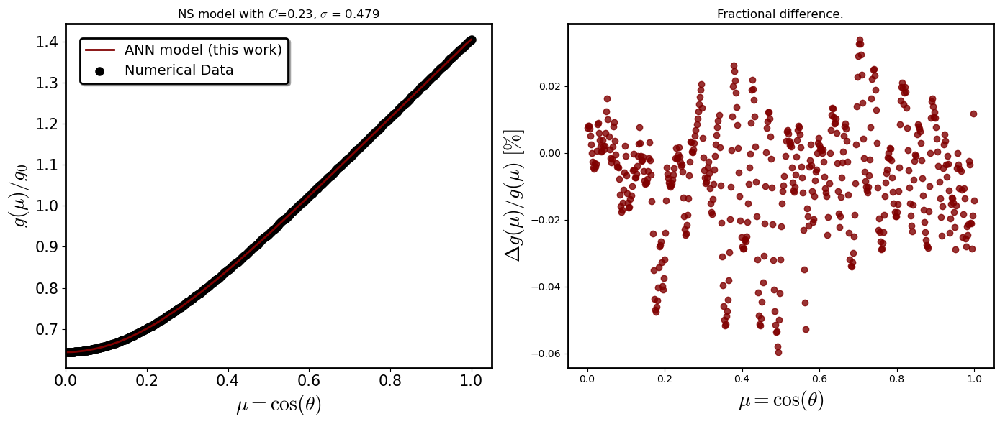

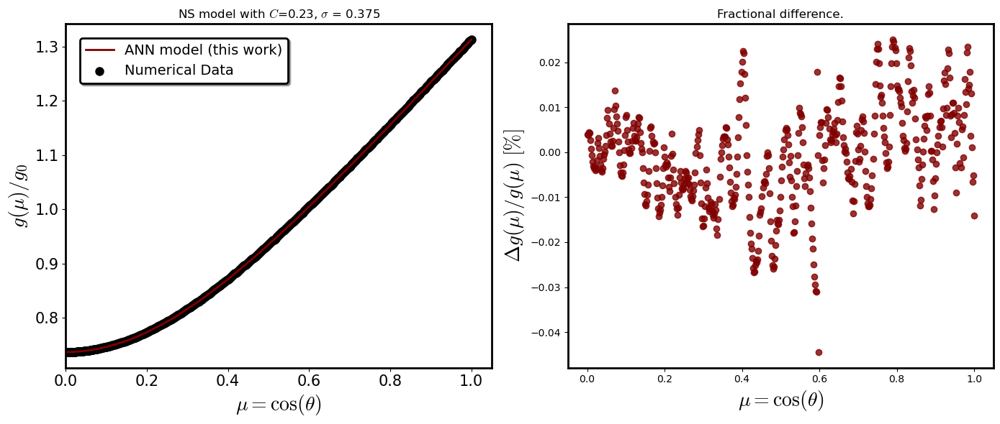

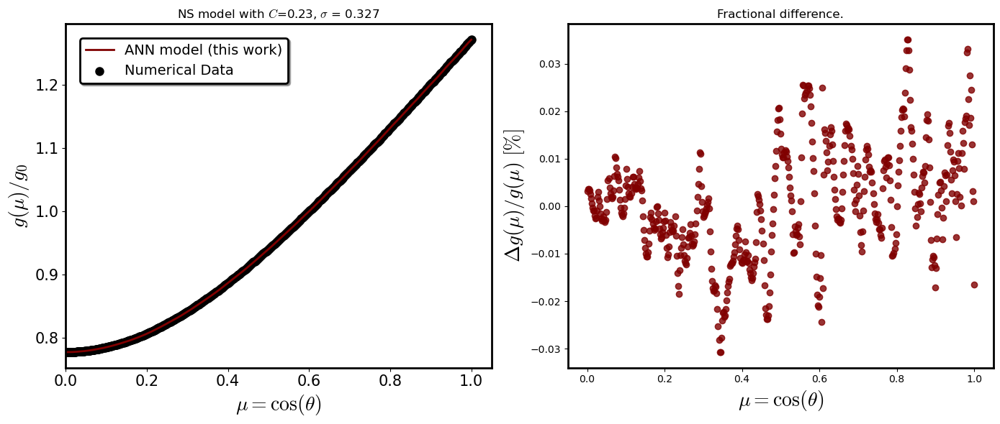

Exception ignored in: <function WeakMethod.__new__.<locals>._cb at 0x70fa8f7cede0>
Traceback (most recent call last):
  File "/home/gregory/anaconda3/lib/python3.11/weakref.py", line 53, in _cb
    def _cb(arg):

KeyboardInterrupt: 


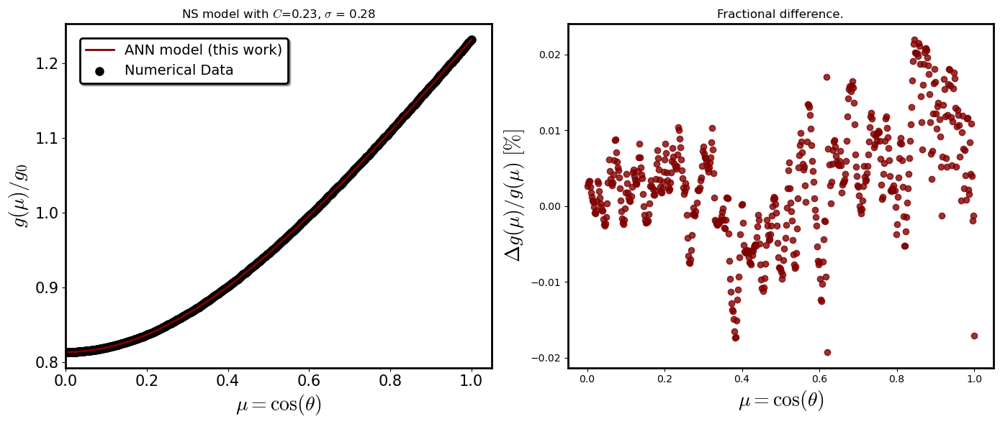

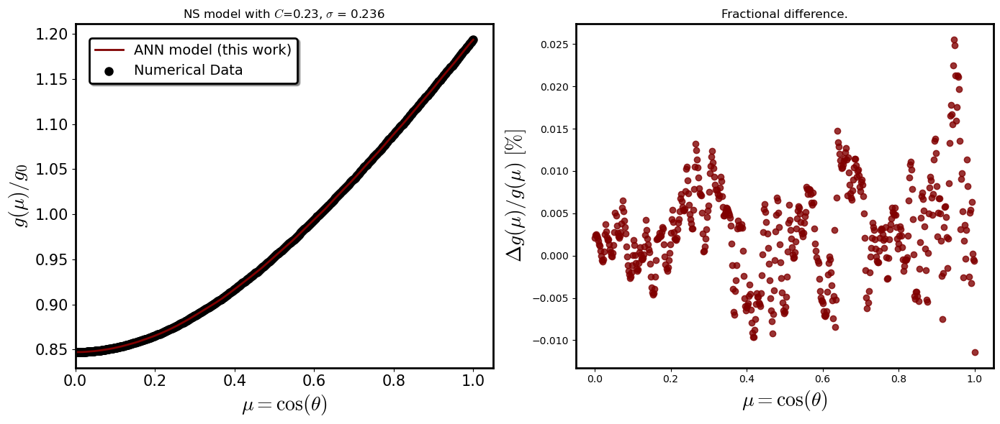

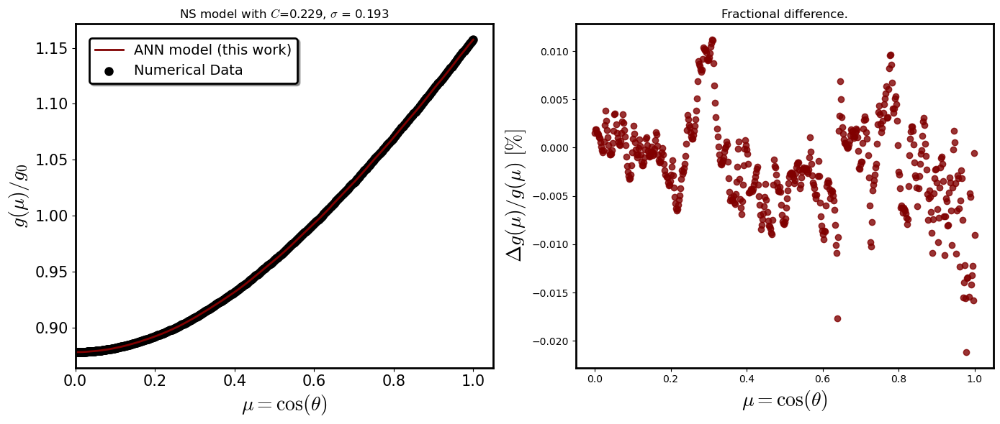

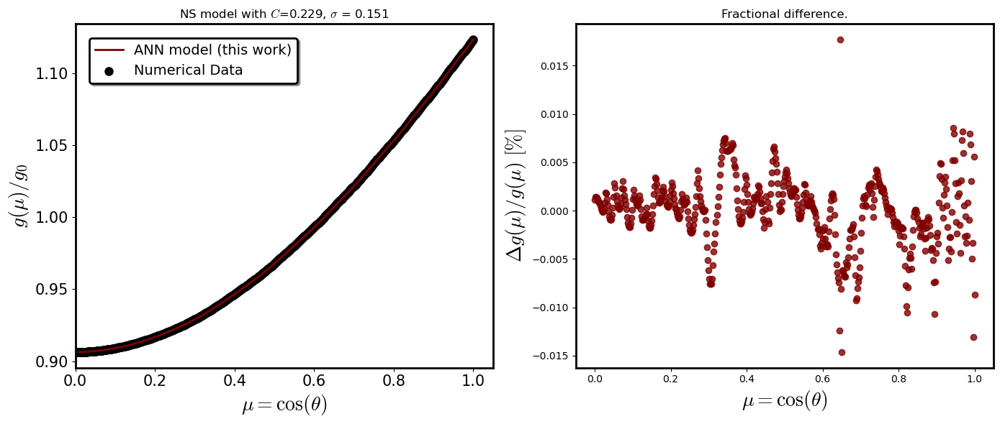

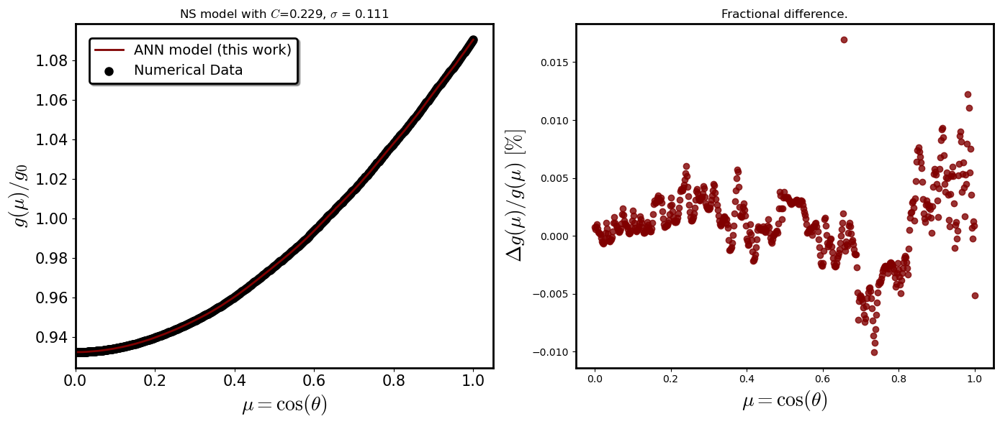

...

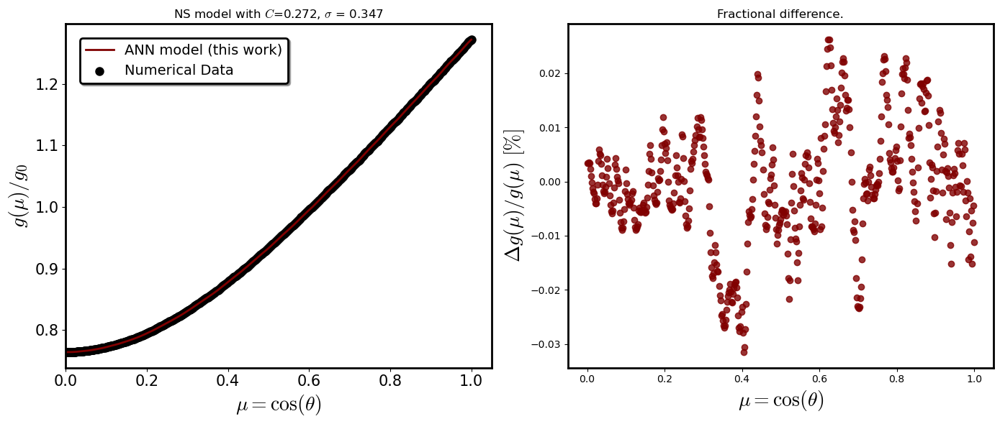

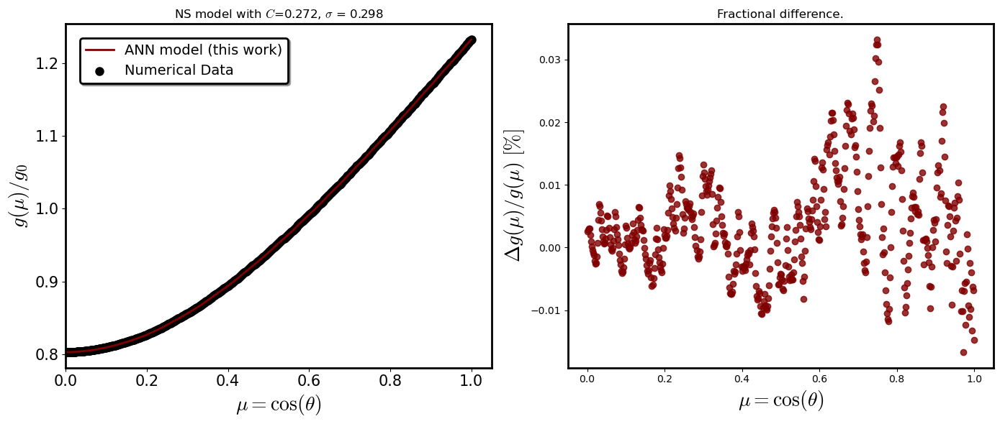

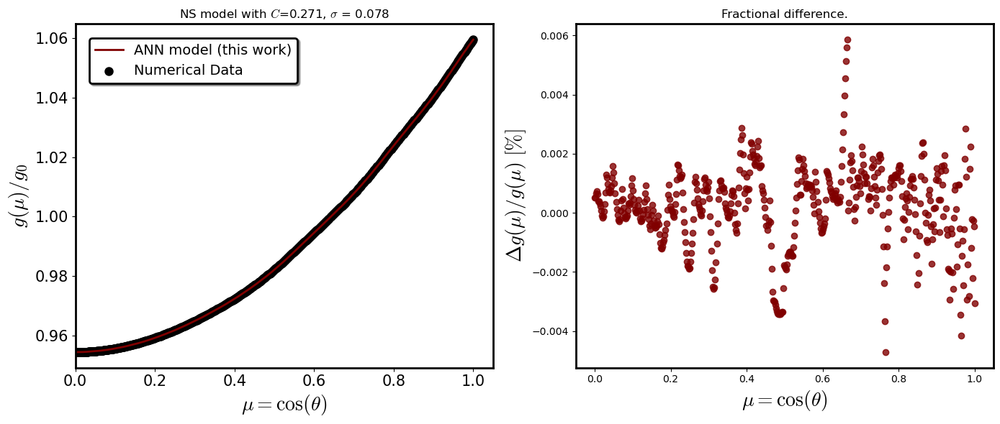

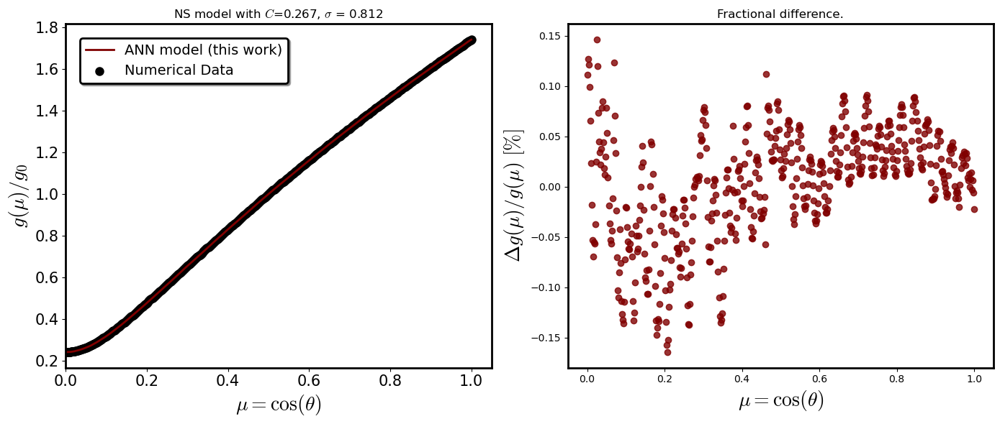

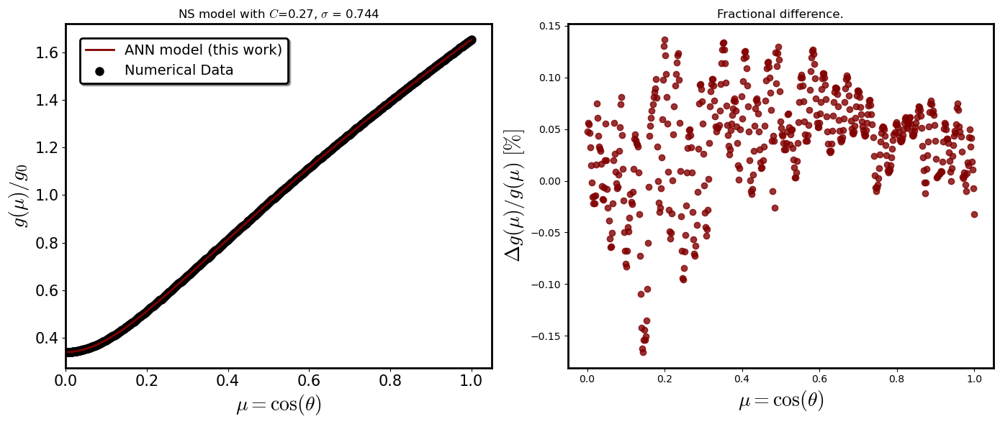

In [44]:
# Select Training or test set
is_train = True # True or False

select_set = lambda is_train, df_train, df_test: df_train if is_train else df_test
select_features = lambda is_train, np_features_tr, np_features_ts: np_features_tr if is_train else np_features_ts
select_targets = lambda is_train, np_targets_tr, np_targets_ts: np_targets_tr if is_train else np_targets_ts
    
# Select Set (Train/Test)
df_set = select_set(is_train, df_train, df_test)
features = select_features(is_train, np_features_tr, np_features_ts)
targets = select_targets(is_train, np_targets_tr, np_targets_ts)
    
for star_index in range(0, 150):
    # Do not change
    low = star_index * N_MU
    high = (star_index + 1) * N_MU
    mu = df_set['cos(theta)'].iloc[low:high]
    ############# C and sigma for each star ######################################
    C = df_set['C'].iloc[low]
    sigma = df_set['sigma'].iloc[low]
    
    #################### ANN results #########################################
    estimation = regressor.predict(features[low:high])
    #Convert the estimation list to 1-d array with dtype float 64 in order 
    #to have the same dimenensions and dtype with mu = cos(theta)
    estimation = estimation.ravel().astype(np.float64) 
    ##########################################################################
    
    g_0 = df_set['g_0(km^(-1))'].iloc[low]
    max_ = df_set['g_surf'].iloc[high - 1]
    min_ = df_set['g_surf'].iloc[low]
    minmax_diff = min_ - max_
    
    # Results coming from the universal relation extracted
    #g_0 = df_set['g_0(km^(-1))'].iloc[low]
    #e = eccentricity(C, sigma)
    #max_ = g_pole(g_0, C, sigma)
    #min_ = g_eq(g_0, C, sigma, e)
    #minmax_diff = min_ - max_
    #############################################################################
    
    if np.all(df_set['sigma'].iloc[low:high] == 0):
        model_estimation = (estimation * min_) / g_0 
        real_targets = (targets[low:high] * min_) / g_0
    else:
        model_estimation = (estimation * (minmax_diff) + max_)  / g_0
        real_targets = (targets[low:high] * (minmax_diff) + max_)  / g_0
    
    real_targets = real_targets.ravel()
    

    ANN_fract_diff = 100*(model_estimation - real_targets)/real_targets
    
    # Create subplots side by side
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
        
    axs[0].plot(mu, model_estimation, lw=2, c='maroon', label='ANN model (this work)')

    
    axs[0].scatter(mu, real_targets, lw=3, c='black', label='Numerical Data')
    axs[0].set_title(f'NS with C={round(C,3)}, sigma = {round(sigma,3)}')
    
    axs[0].set_xlabel(r'$\mu = \cos(\theta)$', fontsize=20)
    axs[0].set_ylabel(r'$g(\mu)/g_0$', fontsize=20)
    
    axs[0].set_title(f'NS model with $C$={round(C,3)}, $\sigma$ = {round(sigma,3)}')
    axs[0].legend(loc='best', prop={'size': 15}, shadow=True, fontsize='large')
    axs[0].tick_params(axis='both', which='both', labelsize=15)
    
    axs[0].set_xlim(0,None)

    for axis in ['top','bottom','left','right']:
        axs[0].spines[axis].set_linewidth(2.0)

    leg = axs[0].legend(loc="best",ncol=1, borderaxespad=1, prop={'size': 14}, shadow=True, fontsize="large") 
    leg.get_frame().set_linewidth(2.0)
    leg.get_frame().set_edgecolor('black')
    

    axs[1].scatter(mu, ANN_fract_diff , lw=1, alpha = 0.8, c='maroon', label = 'The proposed ANN model.')   

    axs[1].set_xlabel(r'$ \mu = \cos(\theta)$', fontsize=20)
    axs[1].set_ylabel(r'$\Delta g(\mu)/ g(\mu) \ [\%]$', fontsize=20)

    for axis in ['top','bottom','left','right']:
        axs[1].spines[axis].set_linewidth(2.0)
    
    plt.tight_layout()
    plt.show()

